# problem Statement

'''Flight ticket prices can be something hard to guess, today we might see a price, check out the price of the same 
flight tomorrow, it will be a different story. We might have often heard travellers saying that flight ticket prices
are so unpredictable. Here you will be provided with prices of flight tickets for various airlines between the months
of March and June of 2019 and between various cities.'''

# FEATURES:
Airline: The name of the airline.

Date_of_Journey: The date of the journey

Source: The source from which the service begins.

Destination: The destination where the service ends.

Route: The route taken by the flight to reach the destination.

Dep_Time: The time when the journey starts from the source.

Arrival_Time: Time of arrival at the destination.

Duration: Total duration of the flight.

Total_Stops: Total stops between the source and destination.

Additional_Info: Additional information about the flight

Price: The price of the ticket

10 Independent variables with Price as target varibles

In [85]:
# Import Libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split,cross_val_score,GridSearchCV


from sklearn.preprocessing import LabelEncoder

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR

from sklearn.metrics import r2_score,mean_absolute_error,mean_squared_error
from sklearn.pipeline import Pipeline

import warnings
warnings.filterwarnings('ignore')


In [86]:
flight_train=pd.read_csv('Data_Train_flight.csv')
flight_test=pd.read_csv('Test_set _flight.csv')

In [87]:
flight_train.shape

(10683, 11)

The training dataset has 10 independent and 1 Target variable

In [88]:
# see all the rows and columns

pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)


In [89]:
flight_train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR ? DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU ? IXR ? BBI ? BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL ? LKO ? BOM ? COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU ? NAG ? BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR ? NAG ? DEL,16:50,21:35,4h 45m,1 stop,No info,13302


1.As the Price seems to be continuos value we will be using Regression algorithm for the prediction of the test data.

2.Route columnany cities names seperated by ? which needs to be treated.

3.Some of values in Arrival Time column is having date along with the time.

4.Other categorical variables will changed to numerical variables. 

In [90]:
flight_test.shape

(2671, 10)

In test dataset we have 10 dependent variables and the output feature i.e Price is to be predicted.


# Data inspection

In [91]:
flight_train.info()

# Clearly visible from the dataset that all the dependent features are of object type and only our target variable is integer in nature.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10683 entries, 0 to 10682
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10683 non-null  object
 1   Date_of_Journey  10683 non-null  object
 2   Source           10683 non-null  object
 3   Destination      10683 non-null  object
 4   Route            10682 non-null  object
 5   Dep_Time         10683 non-null  object
 6   Arrival_Time     10683 non-null  object
 7   Duration         10683 non-null  object
 8   Total_Stops      10682 non-null  object
 9   Additional_Info  10683 non-null  object
 10  Price            10683 non-null  int64 
dtypes: int64(1), object(10)
memory usage: 918.2+ KB


In [92]:
# Checking for null values:

flight_train.isnull().sum()


Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              1
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        1
Additional_Info    0
Price              0
dtype: int64

Very less i.e 1 in route column and 1 in total stop we have missing values which will be replaced or can be dropped even as the data is neglisible.

In [93]:
flight_train.dropna(inplace=True)

In [94]:
flight_train.columns

Index(['Airline', 'Date_of_Journey', 'Source', 'Destination', 'Route',
       'Dep_Time', 'Arrival_Time', 'Duration', 'Total_Stops',
       'Additional_Info', 'Price'],
      dtype='object')

# WE will start treating and cleaning the data first then go for visualization:

In [95]:
# 1.  Firstly we will be seeing uniqueness in the columns where we  are not required to make and kind of changes other than label encoding it.


print("Airline Uniquness:",flight_train['Airline'].nunique())
print("Source:",flight_train['Source'].nunique())
print("Destination:",flight_train['Destination'].nunique())
print("Additional_Info:",flight_train['Additional_Info'].nunique())


Airline Uniquness: 12
Source: 5
Destination: 6
Additional_Info: 10


In [96]:
# 2. Treating the Date_of_Journey columns and make seperate columns


flight_train['Date_of_Journey']=pd.to_datetime(flight_train['Date_of_Journey'],format='%d/%m/%Y')

flight_train['year']=flight_train['Date_of_Journey'].apply(lambda x:x.year)
flight_train['Month']=flight_train['Date_of_Journey'].apply(lambda x:x.month)
flight_train['Day']=flight_train['Date_of_Journey'].apply(lambda x:x.day)


In [97]:
flight_train.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,year,Month,Day
0,IndiGo,2019-03-24,Banglore,New Delhi,BLR ? DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897,2019,3,24
1,Air India,2019-05-01,Kolkata,Banglore,CCU ? IXR ? BBI ? BLR,05:50,13:15,7h 25m,2 stops,No info,7662,2019,5,1
2,Jet Airways,2019-06-09,Delhi,Cochin,DEL ? LKO ? BOM ? COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882,2019,6,9
3,IndiGo,2019-05-12,Kolkata,Banglore,CCU ? NAG ? BLR,18:05,23:30,5h 25m,1 stop,No info,6218,2019,5,12
4,IndiGo,2019-03-01,Banglore,New Delhi,BLR ? NAG ? DEL,16:50,21:35,4h 45m,1 stop,No info,13302,2019,3,1


In [98]:
flight_train=flight_train.drop(['Date_of_Journey'],axis=1)

In [99]:
flight_train.head(2)

,Airline,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price,year,Month,Day
0,IndiGo,Banglore,New Delhi,BLR ? DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897,2019,3,24
1,Air India,Kolkata,Banglore,CCU ? IXR ? BBI ? BLR,05:50,13:15,7h 25m,2 stops,No info,7662,2019,5,1


We have successfully converted our Date of journey column and dropped the actual column to avoid any confusion.

In [100]:
# 3. Treating the Dep_time and Arrival_time
flight_train['Dep_hour']=pd.to_datetime(flight_train['Dep_Time']).dt.hour
flight_train['Dep_min']=pd.to_datetime(flight_train['Dep_Time']).dt.minute
flight_train=flight_train.drop(['Dep_Time'],axis=1)

In [101]:
# 4. Treating the Dep_time and Arrival_time
flight_train['Arrival_hour']=pd.to_datetime(flight_train['Arrival_Time']).dt.hour
flight_train['Arrival_min']=pd.to_datetime(flight_train['Arrival_Time']).dt.minute
flight_train=flight_train.drop(['Arrival_Time'],axis=1)

In [102]:
duration = list(flight_train["Duration"])

for i in range(len(duration)):
    if len(duration[i].split()) != 2:    # Check if duration contains only hour or mins
        if "h" in duration[i]:
            duration[i] = duration[i].strip() + " 0m"   # Adds 0 minute
        else:
            duration[i] = "0h " + duration[i]           # Adds 0 hour

duration_hours = []
duration_mins = []
for i in range(len(duration)):
    duration_hours.append(int(duration[i].split(sep = "h")[0]))    # Extract hours from duration
    duration_mins.append(int(duration[i].split(sep = "m")[0].split()[-1]))   # Extracts only minutes from duration


In [103]:
flight_train['duration_hours']=duration_hours
flight_train['duration_mins']=duration_mins

In [104]:
flight_train.drop(['Duration'],axis=1,inplace=True)

In [105]:
flight_train.head()

,Airline,Source,Destination,Route,Total_Stops,Additional_Info,Price,year,Month,Day,Dep_hour,Dep_min,Arrival_hour,Arrival_min,duration_hours,duration_mins
0,IndiGo,Banglore,New Delhi,BLR ? DEL,non-stop,No info,3897,2019,3,24,22,20,1,10,2,50
1,Air India,Kolkata,Banglore,CCU ? IXR ? BBI ? BLR,2 stops,No info,7662,2019,5,1,5,50,13,15,7,25
2,Jet Airways,Delhi,Cochin,DEL ? LKO ? BOM ? COK,2 stops,No info,13882,2019,6,9,9,25,4,25,19,0
3,IndiGo,Kolkata,Banglore,CCU ? NAG ? BLR,1 stop,No info,6218,2019,5,12,18,5,23,30,5,25
4,IndiGo,Banglore,New Delhi,BLR ? NAG ? DEL,1 stop,No info,13302,2019,3,1,16,50,21,35,4,45


In [106]:
# Now next we need to treat Route column but as we can see Total_Stops and Route column are clearly interrelated we can drop the column Route.
# Even Additional info column has no info so we can drop the column

In [107]:
flight_train.drop(['Route'],axis=1,inplace=True)

In [108]:
flight_train

,Airline,Source,Destination,Total_Stops,Additional_Info,Price,year,Month,Day,Dep_hour,Dep_min,Arrival_hour,Arrival_min,duration_hours,duration_mins
0,IndiGo,Banglore,New Delhi,non-stop,No info,3897,2019,3,24,22,20,1,10,2,50
1,Air India,Kolkata,Banglore,2 stops,No info,7662,2019,5,1,5,50,13,15,7,25
2,Jet Airways,Delhi,Cochin,2 stops,No info,13882,2019,6,9,9,25,4,25,19,0
3,IndiGo,Kolkata,Banglore,1 stop,No info,6218,2019,5,12,18,5,23,30,5,25
4,IndiGo,Banglore,New Delhi,1 stop,No info,13302,2019,3,1,16,50,21,35,4,45
5,SpiceJet,Kolkata,Banglore,non-stop,No info,3873,2019,6,24,9,0,11,25,2,25
6,Jet Airways,Banglore,New Delhi,1 stop,In-flight meal not included,11087,2019,3,12,18,55,10,25,15,30
7,Jet Airways,Banglore,New Delhi,1 stop,No info,22270,2019,3,1,8,0,5,5,21,5
8,Jet Airways,Banglore,New Delhi,1 stop,In-flight meal not included,11087,2019,3,12,8,55,10,25,25,30
9,Multiple carriers,Delhi,Cochin,1 stop,No info,8625,2019,5,27,11,25,19,15,7,50


In [109]:
# Treating Additional_Info column 
flight_train.Additional_Info.unique()


array(['No info', 'In-flight meal not included',
       'No check-in baggage included', '1 Short layover', 'No Info',
       '1 Long layover', 'Change airports', 'Business class',
       'Red-eye flight', '2 Long layover'], dtype=object)

In [110]:
flight_train.Additional_Info.replace('No info','No info',inplace=True)

In [111]:
# Treating the Total stop column


flight_train.Total_Stops.unique()

array(['non-stop', '2 stops', '1 stop', '3 stops', '4 stops'],
      dtype=object)

In [112]:
flight_train.Total_Stops.value_counts()

1 stop      5625
non-stop    3491
2 stops     1520
3 stops       45
4 stops        1
Name: Total_Stops, dtype: int64

In [113]:
flight_train.Total_Stops.replace({"non-stop": 0, "1 stop": 1, "2 stops": 2, "3 stops": 3, "4 stops": 4}, inplace = True)

In [114]:
flight_train

,Airline,Source,Destination,Total_Stops,Additional_Info,Price,year,Month,Day,Dep_hour,Dep_min,Arrival_hour,Arrival_min,duration_hours,duration_mins
0,IndiGo,Banglore,New Delhi,0,No info,3897,2019,3,24,22,20,1,10,2,50
1,Air India,Kolkata,Banglore,2,No info,7662,2019,5,1,5,50,13,15,7,25
2,Jet Airways,Delhi,Cochin,2,No info,13882,2019,6,9,9,25,4,25,19,0
3,IndiGo,Kolkata,Banglore,1,No info,6218,2019,5,12,18,5,23,30,5,25
4,IndiGo,Banglore,New Delhi,1,No info,13302,2019,3,1,16,50,21,35,4,45
5,SpiceJet,Kolkata,Banglore,0,No info,3873,2019,6,24,9,0,11,25,2,25
6,Jet Airways,Banglore,New Delhi,1,In-flight meal not included,11087,2019,3,12,18,55,10,25,15,30
7,Jet Airways,Banglore,New Delhi,1,No info,22270,2019,3,1,8,0,5,5,21,5
8,Jet Airways,Banglore,New Delhi,1,In-flight meal not included,11087,2019,3,12,8,55,10,25,25,30
9,Multiple carriers,Delhi,Cochin,1,No info,8625,2019,5,27,11,25,19,15,7,50


Now almost all columns are treated .We will be changing the datatypes of all numerical value coulmns firstly

In [115]:
# Changing datatype of numerical columns:

flight_train.Total_Stops=flight_train.Total_Stops.astype('int64')
flight_train.Price=flight_train.Price.astype('int64')
flight_train.year=flight_train.year.astype('int64')
flight_train.Month=flight_train.Month.astype('int64')
flight_train.Day=flight_train.Day.astype('int64')
flight_train.Dep_hour=flight_train.Dep_hour.astype('int64')
flight_train.Dep_min=flight_train.Dep_min.astype('int64')
flight_train.Arrival_hour=flight_train.Arrival_hour.astype('int64')
flight_train.Arrival_min=flight_train.Arrival_min.astype('int64')
flight_train.duration_hours=flight_train.duration_hours.astype('int64')
flight_train.duration_mins=flight_train.duration_mins.astype('int64')


In [116]:
flight_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10682 entries, 0 to 10682
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          10682 non-null  object
 1   Source           10682 non-null  object
 2   Destination      10682 non-null  object
 3   Total_Stops      10682 non-null  int64 
 4   Additional_Info  10682 non-null  object
 5   Price            10682 non-null  int64 
 6   year             10682 non-null  int64 
 7   Month            10682 non-null  int64 
 8   Day              10682 non-null  int64 
 9   Dep_hour         10682 non-null  int64 
 10  Dep_min          10682 non-null  int64 
 11  Arrival_hour     10682 non-null  int64 
 12  Arrival_min      10682 non-null  int64 
 13  duration_hours   10682 non-null  int64 
 14  duration_mins    10682 non-null  int64 
dtypes: int64(11), object(4)
memory usage: 1.3+ MB


In [117]:
# Creating two list of variables for visualization and EDA
numerical=['Total_Stops','Price','year','Month','Day','Dep_hour','Dep_min','Arrival_hour','Arrival_min','duration_hours',
          'duration_mins']
categorical=['Airline','Source','Destination','Additional_Info']

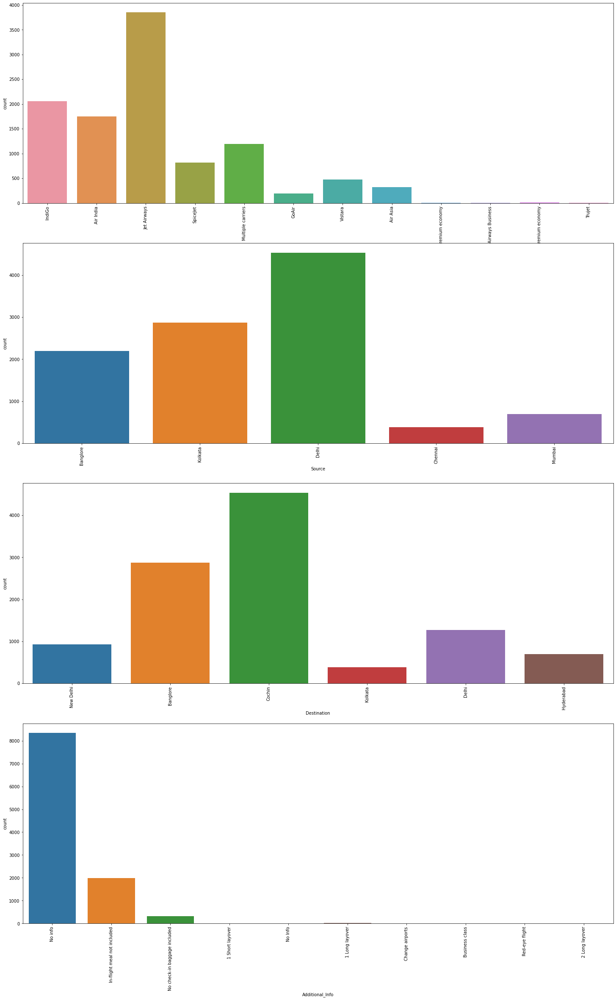

In [118]:
# Plotting for categorical variables:

a=1
plt.figure(figsize=(25,40))
for i in categorical:
    plt.subplot(4,1,a)
    sns.countplot(flight_train[i])
    plt.xticks(rotation=90)
    a=a+1
plt.show()

Observation:

1. jet Airways is having highest frequency of flights followed bt Indigo , Airindia and so on.

2. Most of the flights take of from Delhi and least no from Chennai.

3. Maximum no of flights land in Chochin whereas minimum no at kolkata.

4. maximum no i.e 80 % of row with no info.


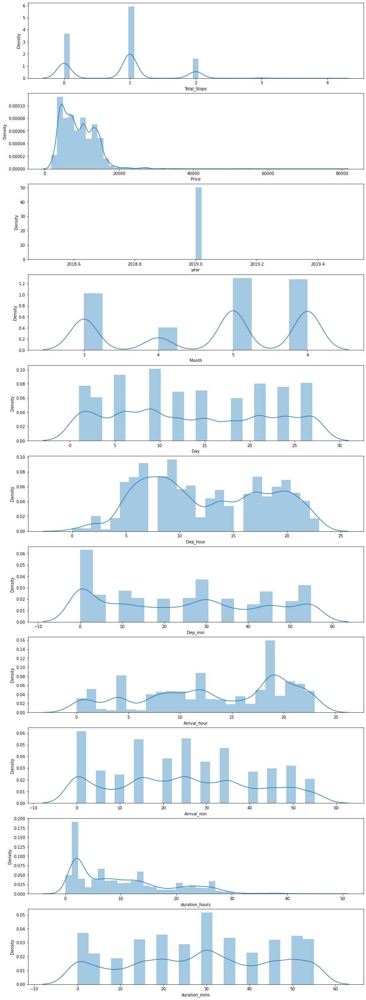

In [119]:
# Plotting for numerical variables:

a=1
plt.figure(figsize=(15,45))
for i in numerical:
    plt.subplot(11,1,a)
    sns.distplot(flight_train[i])
   # plt.xticks(rotation=90)
    a=a+1
plt.show()

# Observation:
1. One stop flights are more in number followed by no stop and 2 stop.
2. Most of the flight have fare  between 1500 to around 20000.
3. Year column is having only one value that can be ignored nad dropped in further prediction.
4. Mostly people travel in May and June whereas minimum in April.
5. Mostly people are traveling between 2,3 day to 26,27 of the month.
6. Early morning flights are more in number almost till 11am. Then afternoon flights are less in number.
7. Most of the flights take off at 00 mins.
8. Most of the flights arrive between 18:00 10 19:00 and its directly related to the take-off.
9. Most of the flight arrive at 00 mins and between 00 to 50 min max.
10. Most of the flights are taking 2 to 3 hrs  followed by 5 to 6 hrs.
11. Maximum minute duration is 30 mins. 


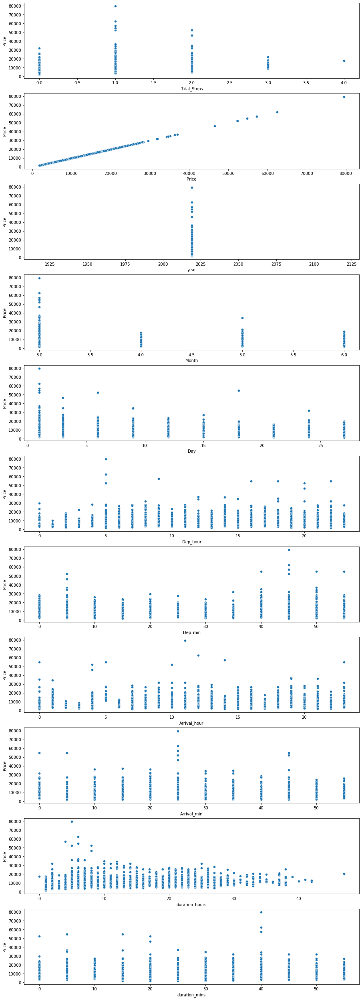

In [120]:
# Plotting for numerical variables:

a=1
plt.figure(figsize=(15,45))
for i in numerical:
    plt.subplot(11,1,a)
    sns.scatterplot(x=flight_train[i],y=flight_train.Price)
   # plt.xticks(rotation=90)
    a=a+1
plt.show()

Observation:
1. Total stop is inversely proportional to the no. of stop.
2. Price is highest in the month of march followed by May and April.
3. Early morning flights are higher in price.
4. Flights taking less duration are slightly higher in price.

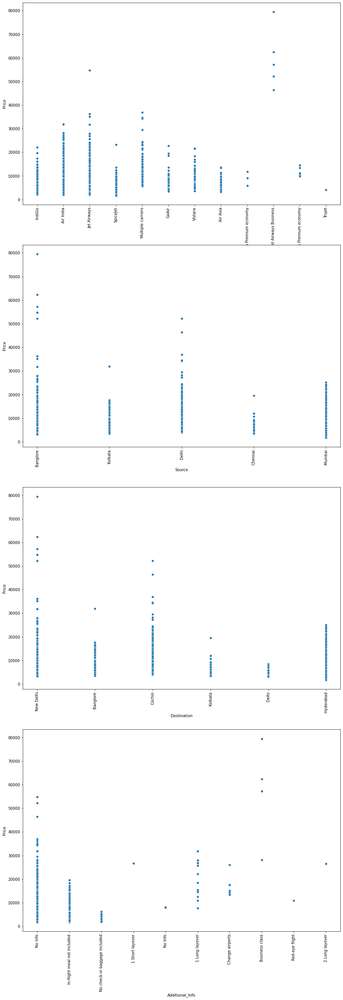

In [121]:
# Plotting for numerical variables:

a=1
plt.figure(figsize=(15,45))
for i in categorical:
    plt.subplot(4,1,a)
    sns.scatterplot(x=flight_train[i],y=flight_train.Price)
    plt.xticks(rotation=90)
    a=a+1
plt.show()

Observation:
1. JetAirways having maximum price followed by AirIndia..
2. Flights taking off from Banglore  are having high price followed by Delhi and Mumbai.
3. Flights with destination as New Delhi has highest price followed by  Chochin ,Hyderabad.
4. Additional Info is not helping us much to extract information as it shows price highest with no info.

    

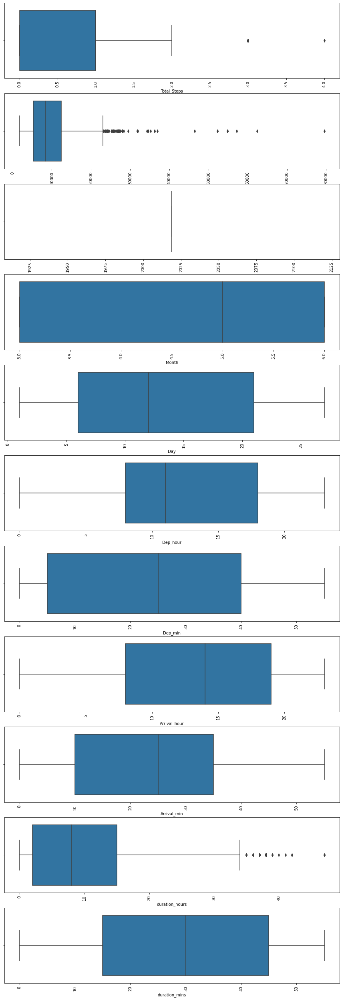

In [122]:
# For outliers detection:

# Plotting for numerical variables:

a=1
plt.figure(figsize=(15,45))
for i in numerical:
    plt.subplot(11,1,a)
    sns.boxplot(flight_train[i])
    plt.xticks(rotation=90)
    a=a+1
plt.show()

Though outliers are present in Total stop,duration Hour  and Price  but if we change it it may effect the Price which is dependent

In [123]:
# Label encoding our Categorical variables now:

le=LabelEncoder()
flight_train['Airline']=le.fit_transform(flight_train['Airline'])
flight_train['Source']=le.fit_transform(flight_train['Source'])
flight_train['Destination']=le.fit_transform(flight_train['Destination'])
flight_train['Additional_Info']=le.fit_transform(flight_train['Additional_Info'])

In [124]:
flight_train.head()

,Airline,Source,Destination,Total_Stops,Additional_Info,Price,year,Month,Day,Dep_hour,Dep_min,Arrival_hour,Arrival_min,duration_hours,duration_mins
0,3,0,5,0,8,3897,2019,3,24,22,20,1,10,2,50
1,1,3,0,2,8,7662,2019,5,1,5,50,13,15,7,25
2,4,2,1,2,8,13882,2019,6,9,9,25,4,25,19,0
3,3,3,0,1,8,6218,2019,5,12,18,5,23,30,5,25
4,3,0,5,1,8,13302,2019,3,1,16,50,21,35,4,45


Now all data as numerical value

In [125]:
flight_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10682 entries, 0 to 10682
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype
---  ------           --------------  -----
 0   Airline          10682 non-null  int32
 1   Source           10682 non-null  int32
 2   Destination      10682 non-null  int32
 3   Total_Stops      10682 non-null  int64
 4   Additional_Info  10682 non-null  int32
 5   Price            10682 non-null  int64
 6   year             10682 non-null  int64
 7   Month            10682 non-null  int64
 8   Day              10682 non-null  int64
 9   Dep_hour         10682 non-null  int64
 10  Dep_min          10682 non-null  int64
 11  Arrival_hour     10682 non-null  int64
 12  Arrival_min      10682 non-null  int64
 13  duration_hours   10682 non-null  int64
 14  duration_mins    10682 non-null  int64
dtypes: int32(4), int64(11)
memory usage: 1.4 MB


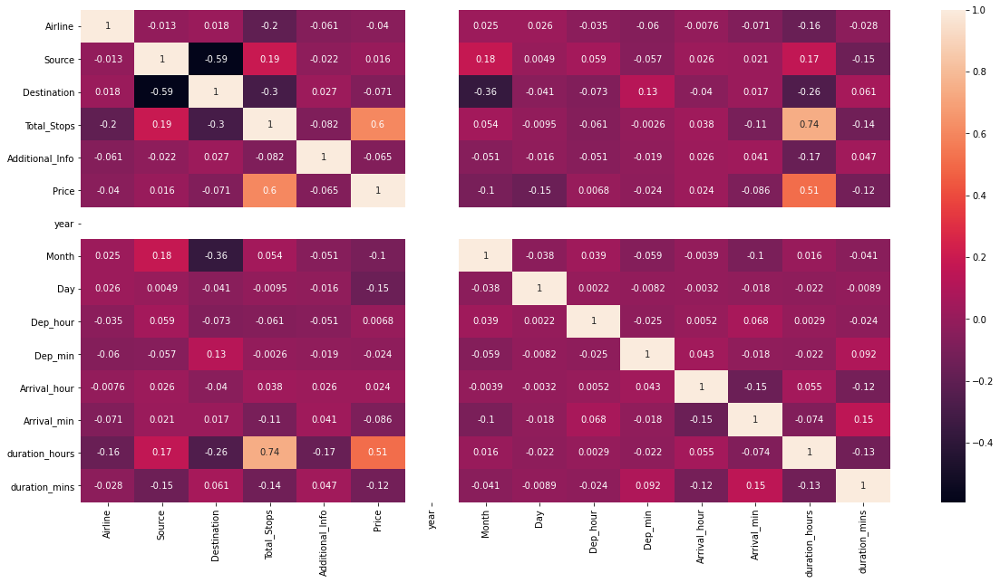

In [126]:
# lets see the correlation:

plt.figure(figsize=(20,10))
sns.heatmap(flight_train.corr(),annot=True)
plt.show()

From the above correlation map we can make out that Total_stops and Duration are highly related

# Model Building

In [127]:
Y=flight_train['Price']    # Dependent variable
X=flight_train.drop('Price',axis=1)# Independent variable

In [128]:
#Scaling the features Using standaard Scalar

from sklearn.preprocessing import StandardScaler
sc=StandardScaler()

In [129]:
sc.fit_transform(X)
x_scaled=pd.DataFrame(X,columns=X.columns)

In [130]:
# Split the train dataset:

X_train,X_test,Y_train,Y_test=train_test_split(x_scaled,Y,test_size=0.2,random_state=42)

In [131]:
Linear=LinearRegression()
DecisionTree=DecisionTreeRegressor()
knn=KNeighborsRegressor()
Random=RandomForestRegressor()


In [132]:
alg=[Linear,DecisionTree,knn,Random]
acc_models={}
for model in alg:
    model.fit(X_train,Y_train)
    Y_pred=model.predict(X_test)
    acc_models[model]=round(r2_score(Y_test,Y_pred)*100,1)
    print("Model Name:",model) 
    print('Accuracy ::',{round(r2_score(Y_test,Y_pred)*100,1)})
    print('Mean Absolute Error(MAE) is::',{mean_absolute_error(Y_test,Y_pred)})
    print('Mean Squared Error(MSE) ::',{mean_squared_error(Y_test,Y_pred)})
    print('Root Mean Squared Error is ::',{np.sqrt(mean_squared_error(Y_test,Y_pred))})
    print("--------------------------------------------------------")


Model Name: LinearRegression()
Accuracy :: {43.8}
Mean Absolute Error(MAE) is:: {2439.5930452787816}
Mean Squared Error(MSE) :: {12116279.631532997}
Root Mean Squared Error is :: {3480.844672135342}
--------------------------------------------------------
Model Name: DecisionTreeRegressor()
Accuracy :: {79.2}
Mean Absolute Error(MAE) is:: {739.2502729683356}
Mean Squared Error(MSE) :: {4474523.151237456}
Root Mean Squared Error is :: {2115.3068692833804}
--------------------------------------------------------
Model Name: KNeighborsRegressor()
Accuracy :: {64.0}
Mean Absolute Error(MAE) is:: {1716.62302292934}
Mean Squared Error(MSE) :: {7769482.291417876}
Root Mean Squared Error is :: {2787.379107946724}
--------------------------------------------------------
Model Name: RandomForestRegressor()
Accuracy :: {86.0}
Mean Absolute Error(MAE) is:: {661.2228743064376}
Mean Squared Error(MSE) :: {3024689.2668439406}
Root Mean Squared Error is :: {1739.163381296864}
-------------------------

In [133]:
acc_models

{LinearRegression(): 43.8,
 DecisionTreeRegressor(): 79.2,
 KNeighborsRegressor(): 64.0,
 RandomForestRegressor(): 86.0}

It shows that Ranmon forest giving best result 

<AxesSubplot:xlabel='Price', ylabel='Density'>

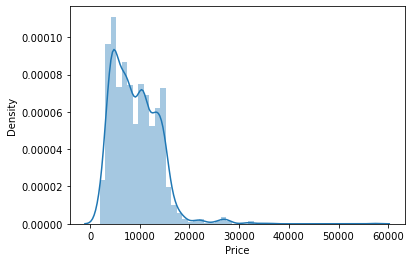

In [134]:
sns.distplot((Y_test))

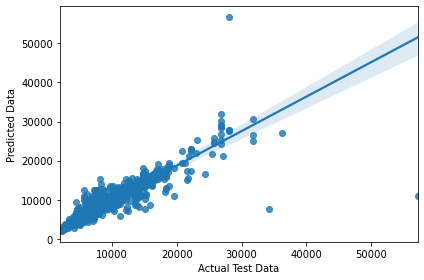

In [135]:
RandomForest=RandomForestRegressor()
RandomForest.fit(X_train,Y_train)
Y_pred=RandomForest.predict(X_test)
sns.regplot(Y_test,Y_pred)
plt.xlabel("Actual Test Data")
plt.ylabel("Predicted Data")
plt.tight_layout()

In [136]:
df=pd.DataFrame({'Y Test':Y_test,'Pred':Y_pred},columns=['Y Test','Pred'])
df.head()

,Y Test,Pred
6075,16655,16897.31
3544,4959,5607.24
9291,9187,8873.65
5032,3858,3668.22
2483,12898,12960.21


# Hyper Tuning the Random Forest Model:


In [137]:
X_train,Y_train,X_test,Y_test=train_test_split(x_scaled,Y,test_size=0.2,random_state=80)
estimator=RandomForestRegressor()

param_grid={
    "n_estimators":[10,20,30],
    "max_features":["auto", "sqrt", "log2"],
    "min_samples_split":[2,4,8],
    "bootstrap":[True,False]    
}
gridsearch=GridSearchCV(estimator,param_grid,n_jobs=-1,cv=5)

gridsearch.fit(x_scaled,Y)
print(gridsearch.best_params_ , gridsearch.best_score_)

{'bootstrap': False, 'max_features': 'sqrt', 'min_samples_split': 4, 'n_estimators': 20} 0.889071720702353


In [138]:
RandomForest=RandomForestRegressor(n_estimators=30,max_features='sqrt',min_samples_split=4,bootstrap=False)
RandomForest.fit(x_scaled,Y)
Y_pred=RandomForest.predict(x_scaled)
r2_sc=r2_score(Y,Y_pred)
print("r2_score:",r2_sc*100)


r2_score: 98.33021630999325


The model is shoeing an increase of 85 to 98%

# We will start working with the test dataset


In [139]:

flight_test.shape

(2671, 10)

In [140]:
flight_test.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info
0,Jet Airways,6/06/2019,Delhi,Cochin,DEL ? BOM ? COK,17:30,04:25 07 Jun,10h 55m,1 stop,No info
1,IndiGo,12/05/2019,Kolkata,Banglore,CCU ? MAA ? BLR,06:20,10:20,4h,1 stop,No info
2,Jet Airways,21/05/2019,Delhi,Cochin,DEL ? BOM ? COK,19:15,19:00 22 May,23h 45m,1 stop,In-flight meal not included
3,Multiple carriers,21/05/2019,Delhi,Cochin,DEL ? BOM ? COK,08:00,21:00,13h,1 stop,No info
4,Air Asia,24/06/2019,Banglore,Delhi,BLR ? DEL,23:55,02:45 25 Jun,2h 50m,non-stop,No info


# Cleaning the test data:


In [141]:
# 1.  Firstly we will be seeing uniqueness in the columns where we  are not required to make and kind of changes other than label encoding it.


print("Airline Uniquness:",flight_test['Airline'].nunique())
print("Source:",flight_test['Source'].nunique())
print("Destination:",flight_test['Destination'].nunique())
print("Additional_Info:",flight_test['Additional_Info'].nunique())



Airline Uniquness: 11
Source: 5
Destination: 6
Additional_Info: 6


In [142]:
# 2. Treating the Date_of_Journey columns and make seperate columns


flight_test['Date_of_Journey']=pd.to_datetime(flight_test['Date_of_Journey'],format='%d/%m/%Y')

flight_test['year']=flight_test['Date_of_Journey'].apply(lambda x:x.year)
flight_test['Month']=flight_test['Date_of_Journey'].apply(lambda x:x.month)
flight_test['Day']=flight_test['Date_of_Journey'].apply(lambda x:x.day)


In [143]:
flight_test.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,year,Month,Day
0,Jet Airways,2019-06-06,Delhi,Cochin,DEL ? BOM ? COK,17:30,04:25 07 Jun,10h 55m,1 stop,No info,2019,6,6
1,IndiGo,2019-05-12,Kolkata,Banglore,CCU ? MAA ? BLR,06:20,10:20,4h,1 stop,No info,2019,5,12
2,Jet Airways,2019-05-21,Delhi,Cochin,DEL ? BOM ? COK,19:15,19:00 22 May,23h 45m,1 stop,In-flight meal not included,2019,5,21
3,Multiple carriers,2019-05-21,Delhi,Cochin,DEL ? BOM ? COK,08:00,21:00,13h,1 stop,No info,2019,5,21
4,Air Asia,2019-06-24,Banglore,Delhi,BLR ? DEL,23:55,02:45 25 Jun,2h 50m,non-stop,No info,2019,6,24


In [144]:
flight_test=flight_test.drop(['Date_of_Journey'],axis=1)

In [145]:
# 3. Treating the Dep_time and Arrival_time
flight_test['Dep_hour']=pd.to_datetime(flight_test['Dep_Time']).dt.hour
flight_test['Dep_min']=pd.to_datetime(flight_test['Dep_Time']).dt.minute
flight_test=flight_test.drop(['Dep_Time'],axis=1)

In [146]:
# 4. Treating the Dep_time and Arrival_time
flight_test['Arrival_hour']=pd.to_datetime(flight_test['Arrival_Time']).dt.hour
flight_test['Arrival_min']=pd.to_datetime(flight_test['Arrival_Time']).dt.minute
flight_test=flight_test.drop(['Arrival_Time'],axis=1)

In [147]:
duration = list(flight_test["Duration"])

for i in range(len(duration)):
    if len(duration[i].split()) != 2:    # Check if duration contains only hour or mins
        if "h" in duration[i]:
            duration[i] = duration[i].strip() + " 0m"   # Adds 0 minute
        else:
            duration[i] = "0h " + duration[i]           # Adds 0 hour

duration_hours = []
duration_mins = []
for i in range(len(duration)):
    duration_hours.append(int(duration[i].split(sep = "h")[0]))    # Extract hours from duration
    duration_mins.append(int(duration[i].split(sep = "m")[0].split()[-1]))   # Extracts only minutes from duration


In [148]:
flight_test['duration_hours']=duration_hours
flight_test['duration_mins']=duration_mins
flight_test.drop(['Duration'],axis=1,inplace=True)

In [149]:
flight_test.drop(['Route'],axis=1,inplace=True)

In [150]:
flight_test.head()

,Airline,Source,Destination,Total_Stops,Additional_Info,year,Month,Day,Dep_hour,Dep_min,Arrival_hour,Arrival_min,duration_hours,duration_mins
0,Jet Airways,Delhi,Cochin,1 stop,No info,2019,6,6,17,30,4,25,10,55
1,IndiGo,Kolkata,Banglore,1 stop,No info,2019,5,12,6,20,10,20,4,0
2,Jet Airways,Delhi,Cochin,1 stop,In-flight meal not included,2019,5,21,19,15,19,0,23,45
3,Multiple carriers,Delhi,Cochin,1 stop,No info,2019,5,21,8,0,21,0,13,0
4,Air Asia,Banglore,Delhi,non-stop,No info,2019,6,24,23,55,2,45,2,50


In [151]:
# Treating Additional_Info column 
flight_test.Additional_Info.unique()

array(['No info', 'In-flight meal not included',
       'No check-in baggage included', '1 Long layover', 'Business class',
       'Change airports'], dtype=object)

In [152]:
flight_train.Additional_Info.replace('No info','No info',inplace=True)


In [153]:
# Treating the Total stop column


flight_test.Total_Stops.unique()

array(['1 stop', 'non-stop', '2 stops', '3 stops', '4 stops'],
      dtype=object)

In [154]:
flight_test.Total_Stops.value_counts()

1 stop      1431
non-stop     849
2 stops      379
3 stops       11
4 stops        1
Name: Total_Stops, dtype: int64

In [155]:
flight_test.Total_Stops.replace({"non-stop": 0, "1 stop": 1, "2 stops": 2, "3 stops": 3, "4 stops": 4}, inplace = True)

In [156]:
flight_test

,Airline,Source,Destination,Total_Stops,Additional_Info,year,Month,Day,Dep_hour,Dep_min,Arrival_hour,Arrival_min,duration_hours,duration_mins
0,Jet Airways,Delhi,Cochin,1,No info,2019,6,6,17,30,4,25,10,55
1,IndiGo,Kolkata,Banglore,1,No info,2019,5,12,6,20,10,20,4,0
2,Jet Airways,Delhi,Cochin,1,In-flight meal not included,2019,5,21,19,15,19,0,23,45
3,Multiple carriers,Delhi,Cochin,1,No info,2019,5,21,8,0,21,0,13,0
4,Air Asia,Banglore,Delhi,0,No info,2019,6,24,23,55,2,45,2,50
5,Jet Airways,Delhi,Cochin,1,In-flight meal not included,2019,6,12,18,15,12,35,18,20
6,Air India,Banglore,New Delhi,1,No info,2019,3,12,7,30,22,35,15,5
7,IndiGo,Kolkata,Banglore,1,No info,2019,5,1,15,15,20,30,5,15
8,IndiGo,Kolkata,Banglore,0,No info,2019,3,15,10,10,12,55,2,45
9,Jet Airways,Kolkata,Banglore,1,No info,2019,5,18,16,30,22,35,6,5


In [157]:
# Changing datatype of numerical columns:

flight_test.Total_Stops=flight_test.Total_Stops.astype('int64')
#flight_test.Price=flight_test.Price.astype('int64')
flight_test.year=flight_test.year.astype('int64')
flight_test.Month=flight_test.Month.astype('int64')
flight_test.Day=flight_test.Day.astype('int64')
flight_test.Dep_hour=flight_test.Dep_hour.astype('int64')
flight_test.Dep_min=flight_test.Dep_min.astype('int64')
flight_test.Arrival_hour=flight_test.Arrival_hour.astype('int64')
flight_test.Arrival_min=flight_test.Arrival_min.astype('int64')
flight_test.duration_hours=flight_test.duration_hours.astype('int64')
flight_test.duration_mins=flight_test.duration_mins.astype('int64')


In [158]:
flight_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2671 entries, 0 to 2670
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Airline          2671 non-null   object
 1   Source           2671 non-null   object
 2   Destination      2671 non-null   object
 3   Total_Stops      2671 non-null   int64 
 4   Additional_Info  2671 non-null   object
 5   year             2671 non-null   int64 
 6   Month            2671 non-null   int64 
 7   Day              2671 non-null   int64 
 8   Dep_hour         2671 non-null   int64 
 9   Dep_min          2671 non-null   int64 
 10  Arrival_hour     2671 non-null   int64 
 11  Arrival_min      2671 non-null   int64 
 12  duration_hours   2671 non-null   int64 
 13  duration_mins    2671 non-null   int64 
dtypes: int64(10), object(4)
memory usage: 292.3+ KB


In [159]:
# Label encoding our Categorical variables now:

le=LabelEncoder()
flight_test['Airline']=le.fit_transform(flight_test['Airline'])
flight_test['Source']=le.fit_transform(flight_test['Source'])
flight_test['Destination']=le.fit_transform(flight_test['Destination'])
flight_test['Additional_Info']=le.fit_transform(flight_test['Additional_Info'])

In [160]:
flight_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2671 entries, 0 to 2670
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype
---  ------           --------------  -----
 0   Airline          2671 non-null   int32
 1   Source           2671 non-null   int32
 2   Destination      2671 non-null   int32
 3   Total_Stops      2671 non-null   int64
 4   Additional_Info  2671 non-null   int32
 5   year             2671 non-null   int64
 6   Month            2671 non-null   int64
 7   Day              2671 non-null   int64
 8   Dep_hour         2671 non-null   int64
 9   Dep_min          2671 non-null   int64
 10  Arrival_hour     2671 non-null   int64
 11  Arrival_min      2671 non-null   int64
 12  duration_hours   2671 non-null   int64
 13  duration_mins    2671 non-null   int64
dtypes: int32(4), int64(10)
memory usage: 250.5 KB


In [161]:
flight_test.head()

,Airline,Source,Destination,Total_Stops,Additional_Info,year,Month,Day,Dep_hour,Dep_min,Arrival_hour,Arrival_min,duration_hours,duration_mins
0,4,2,1,1,5,2019,6,6,17,30,4,25,10,55
1,3,3,0,1,5,2019,5,12,6,20,10,20,4,0
2,4,2,1,1,3,2019,5,21,19,15,19,0,23,45
3,6,2,1,1,5,2019,5,21,8,0,21,0,13,0
4,0,0,2,0,5,2019,6,24,23,55,2,45,2,50


In [162]:
flight_test.isnull().sum()

Airline            0
Source             0
Destination        0
Total_Stops        0
Additional_Info    0
year               0
Month              0
Day                0
Dep_hour           0
Dep_min            0
Arrival_hour       0
Arrival_min        0
duration_hours     0
duration_mins      0
dtype: int64

In [163]:
flight_test["Price"] = RandomForest.predict(flight_test)

In [164]:
flight_test[['Airline', 'Price']].to_csv('Flight_Price_submission.csv', index=False)

In [165]:
submission = pd.read_csv(r'Flight_Price_submission.csv')
submission.shape

(2671, 2)

In [166]:
submission

,Airline,Price
0,4,10365.855556
1,3,4418.827778
2,4,19745.094444
3,6,10706.727778
4,0,3785.650000
5,4,16551.433333
6,1,13029.394444
7,3,5964.100000
8,3,4524.900000
9,4,11060.388889


In [167]:
import pickle

In [168]:
filename="Flight Price Prediction Project"
pickle.dump(RandomForest, open(filename,'wb'))